In [1]:
import torch, torchvision
from PIL import Image
from transfer import StyleTransfer, StyleTransferLoss
import os
import matplotlib.pyplot as plt
from glob import glob

### This notebook is intended for exploring the different layers of the vgg network and what information they hold.

In [2]:
content = Image.open("content-style_image/venice.jpg")
style = Image.open('./content-style_image/good.jpg')
style = style.resize(content.size)

# Making image transformers
new_size = 600
trans = torchvision.transforms.Compose([
    torchvision.transforms.Resize(new_size),
    torchvision.transforms.ToTensor()
])

# Making content and style images acceptable for the network.
c = trans(content).unsqueeze(0)
s = trans(style).unsqueeze(0)

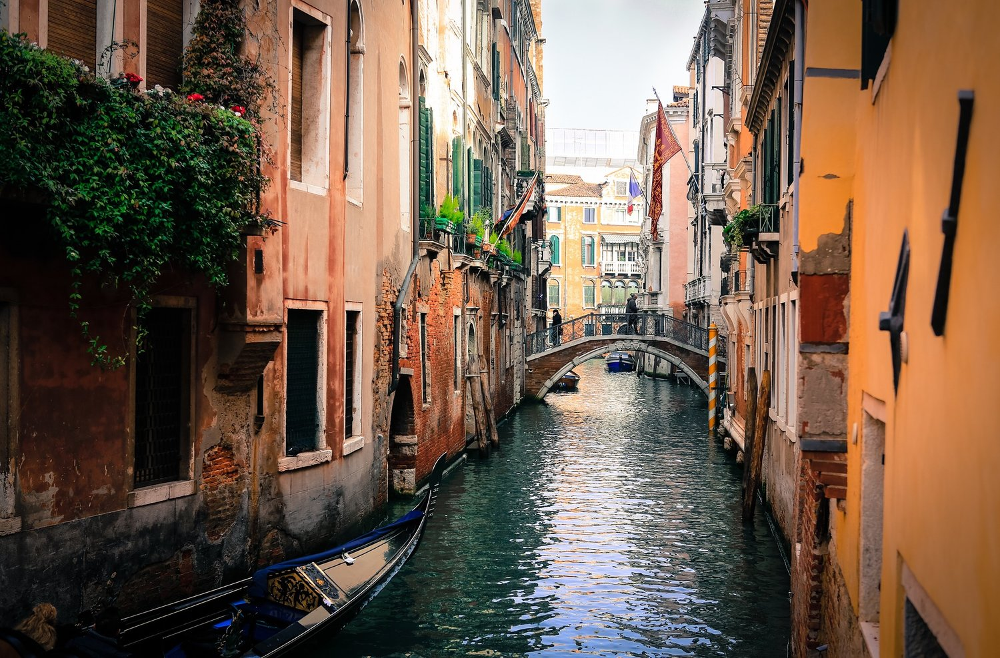

In [3]:
content

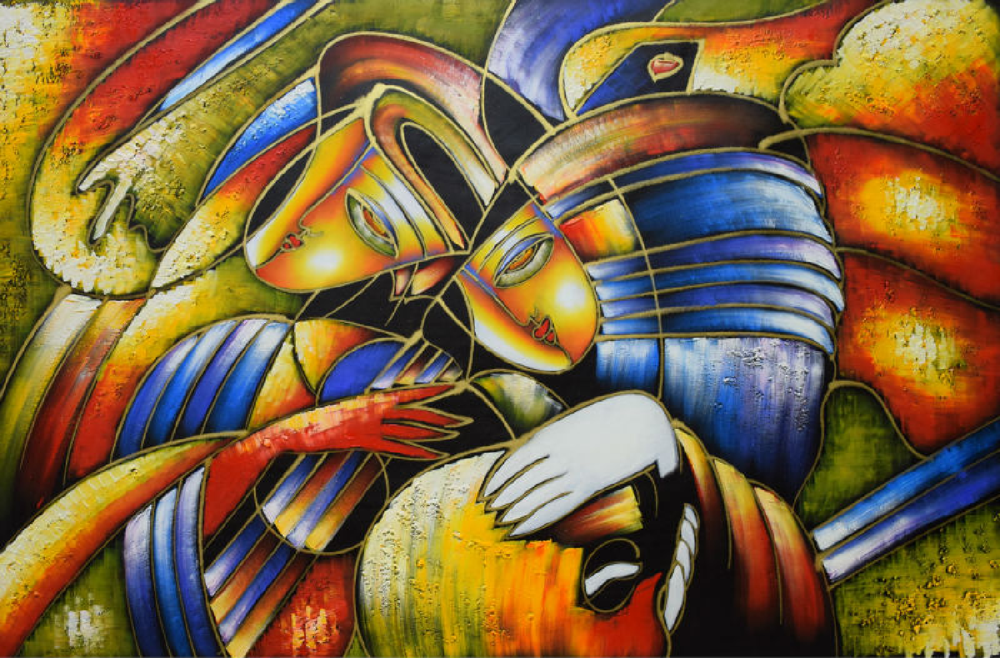

In [4]:
style

# Generating Style Transfer Model

In [ ]:
vgg19 = torchvision.models.vgg19(pretrained=True).features.eval()
lr = 1
n_epochs = 101
# transferer = StyleTransfer(vgg11.cuda(), c.cuda(), s.cuda(), [4], [-1], alpha=1000000, beta=1).cuda()
# total_loss = StyleTransferLoss(transferer.style_losses, transferer.alpha, transferer.content_losses, transferer.beta)

# var_img = torch.randn(c.shape).cuda().requires_grad_()

# optimizer = torch.optim.LBFGS([var_img], lr=lr)
# n_epochs = 20

In [ ]:
for beta in [10000]:
    convs = []
    style_weights = []
    for conv_ix in range(0, 5):
        print('conv_ix', conv_ix, " , Beta:", beta)
        print("Model with {} conv ixs.".format(conv_ix))
        transferer = StyleTransfer(vgg19.cuda(), c.cuda(), s.cuda(), content_ixs=[-1], style_ixs=[conv_ix], style_weights=[1], alpha=1, beta=beta).cuda()
        total_loss = StyleTransferLoss(style_losses=transferer.style_losses, beta=transferer.beta,
                                   content_losses=transferer.content_losses, alpha=transferer.alpha)

        var_img = torch.randn(c.shape).cuda().requires_grad_()
        optimizer = torch.optim.LBFGS([var_img], lr=lr)

        save_dir = './exp8_style_vis/style_b{}/style_0-{}/'.format(beta, conv_ix)
        os.makedirs(save_dir)

        for epoch in range(n_epochs):
            def closure():        
                optimizer.zero_grad()

                 # Run current image through the model.
                transferer(var_img)

                loss = total_loss()

                loss.backward()
                return loss

            optimizer.step(closure)

            # Every 20 iters save a pic.
            if epoch%10 == 0:
                print("Epoch: {}, Style Loss: {:6f}, Con Loss: {:6f}".format(epoch, 
                                                                             transferer.beta*total_loss.style_component, 
                                                                             transferer.alpha*total_loss.content_component))
                cpu_img = var_img.cpu()[0, :, :, :]
                cpu_img = torch.clamp(cpu_img, 0, 1)
                cpu_img = torchvision.transforms.ToPILImage()(cpu_img)
                cpu_img.save(save_dir + 'ep_{}_loss{:4f}.png'.format(epoch, transferer.beta*total_loss.style_component+transferer.alpha*total_loss.content_component))

conv_ix 0  , Beta: 10000
Model with 0 conv ixs.
Found style!  0  weight: 1
Epoch: 0, Style Loss: 0.080730, Con Loss: 0.000000
Epoch: 10, Style Loss: 0.000003, Con Loss: 0.000000
Epoch: 20, Style Loss: 0.000001, Con Loss: 0.000000
Epoch: 30, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 40, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 50, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 60, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 70, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 80, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 90, Style Loss: 0.000000, Con Loss: 0.000000
Epoch: 100, Style Loss: 0.000000, Con Loss: 0.000000
conv_ix 1  , Beta: 10000
Model with 1 conv ixs.
Found style!  1  weight: 1
Epoch: 0, Style Loss: 5.568198, Con Loss: 0.000000
Epoch: 10, Style Loss: 0.001786, Con Loss: 0.000000
Epoch: 20, Style Loss: 0.000320, Con Loss: 0.000000
Epoch: 30, Style Loss: 0.000114, Con Loss: 0.000000
Epoch: 40, Style Loss: 0.000052, Con Loss: 0.000000
Epoch: 50, Style Lo

In [ ]:
fig, axis = plt.subplots(4,4, figsize=(50,20))
ix = 0
betas = [100, 1000, 10000, 100000]
for r_ix, (axs, beta) in enumerate(zip(axis, betas)):
    ix = 0
    for c_ix, ax in enumerate(axs):
        files = glob('./exp5_style_vis/style_b{}/style_0-{}/ep_100*'.format(beta, ix))
        print(files)
        ax.axis("off")
        ax.set_title('Beta: {}, Alpha: {}, Conv Layers: {}'.format(beta, 1, str(list(range(ix+1)))))
        ax.imshow(plt.imread(files[-1]), aspect='auto')
        ix+=1

In [14]:
axis[0].shape

(4,)

['./exp5_style_vis/style_b100/style_0-0\\ep_100_loss0.035145.png']
['./exp5_style_vis/style_b1000/style_0-0\\ep_100_loss0.043942.png']
['./exp5_style_vis/style_b10000/style_0-0\\ep_100_loss0.058888.png']
['./exp5_style_vis/style_b100000/style_0-0\\ep_100_loss0.097681.png']
['./exp5_style_vis/style_b1000000/style_0-0\\ep_100_loss0.173657.png']
['./exp5_style_vis/style_b100/style_0-1\\ep_100_loss0.097319.png']
['./exp5_style_vis/style_b1000/style_0-1\\ep_100_loss0.238250.png']
['./exp5_style_vis/style_b10000/style_0-1\\ep_100_loss0.527769.png']
['./exp5_style_vis/style_b100000/style_0-1\\ep_100_loss0.897337.png']
['./exp5_style_vis/style_b1000000/style_0-1\\ep_100_loss1.249236.png']
['./exp5_style_vis/style_b100/style_0-2\\ep_100_loss0.552079.png']
['./exp5_style_vis/style_b1000/style_0-2\\ep_100_loss1.151045.png']
['./exp5_style_vis/style_b10000/style_0-2\\ep_100_loss1.726486.png']
['./exp5_style_vis/style_b100000/style_0-2\\ep_100_loss2.272639.png']
['./exp5_style_vis/style_b1000000/st

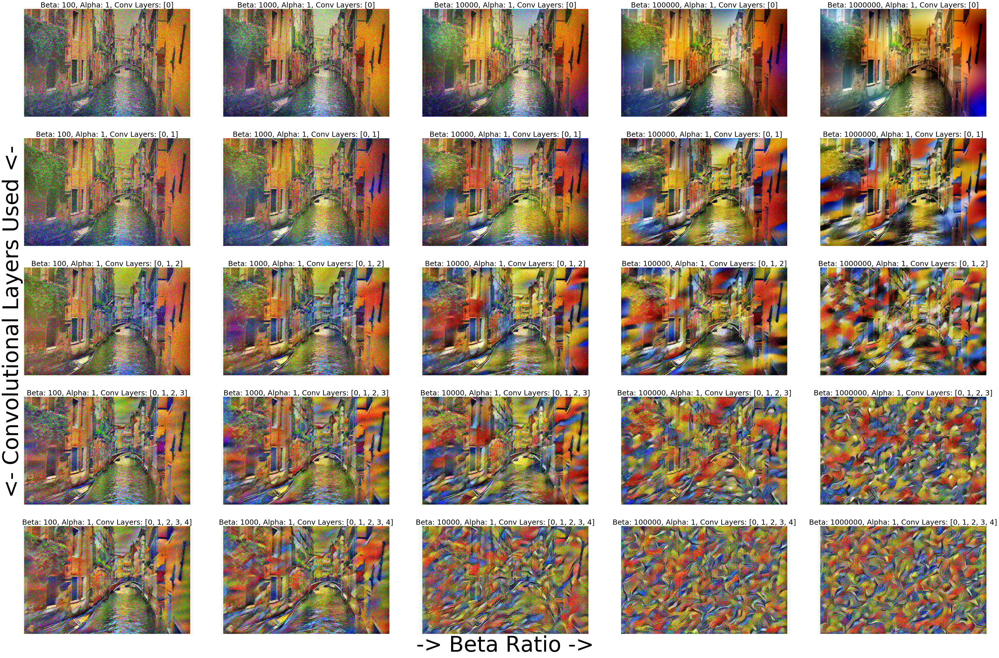

In [4]:
fig, axis = plt.subplots(5,5, figsize=(60,40))
betas = [100, 1000, 10000, 100000, 1000000]
for c_ix, ax in enumerate(axis):
    for ix, (ax, beta) in enumerate(zip(ax, betas)):
        files = glob('./exp5_style_vis/style_b{}/style_0-{}/ep_100*'.format(beta, c_ix))
        print(files)
        ax.axis("off")
        ax.set_title("Beta: {}, Alpha: {}, Conv Layers: {}".format(beta, 1, str(list(range(c_ix+1)))), fontsize=25)
        ax.imshow(plt.imread(files[-1]), aspect='auto')
        
fig.add_subplot(111, frameon=False)
plt.xticks([])
plt.yticks([])
plt.xlabel("-> Beta Ratio ->", fontsize=75)
plt.ylabel("<- Convolutional Layers Used <-", fontsize=75)
plt.savefig('./report_images/image_collage_style.png')
    

['./exp5_style_vis/style_b100/style_0-0\\ep_100_loss0.035145.png']
['./exp5_style_vis/style_b100/style_0-1\\ep_100_loss0.097319.png']
['./exp5_style_vis/style_b100/style_0-2\\ep_100_loss0.552079.png']
['./exp5_style_vis/style_b100/style_0-3\\ep_100_loss1.542513.png']
['./exp5_style_vis/style_b100/style_0-4\\ep_100_loss3.774616.png']
['./exp5_style_vis/style_b1000/style_0-0\\ep_100_loss0.043942.png']
['./exp5_style_vis/style_b1000/style_0-1\\ep_100_loss0.238250.png']
['./exp5_style_vis/style_b1000/style_0-2\\ep_100_loss1.151045.png']
['./exp5_style_vis/style_b1000/style_0-3\\ep_100_loss2.369950.png']
['./exp5_style_vis/style_b1000/style_0-4\\ep_100_loss4.564344.png']
['./exp5_style_vis/style_b10000/style_0-0\\ep_100_loss0.058888.png']
['./exp5_style_vis/style_b10000/style_0-1\\ep_100_loss0.527769.png']
['./exp5_style_vis/style_b10000/style_0-2\\ep_100_loss1.726486.png']
['./exp5_style_vis/style_b10000/style_0-3\\ep_100_loss3.120270.png']
['./exp5_style_vis/style_b10000/style_0-4\\ep_100

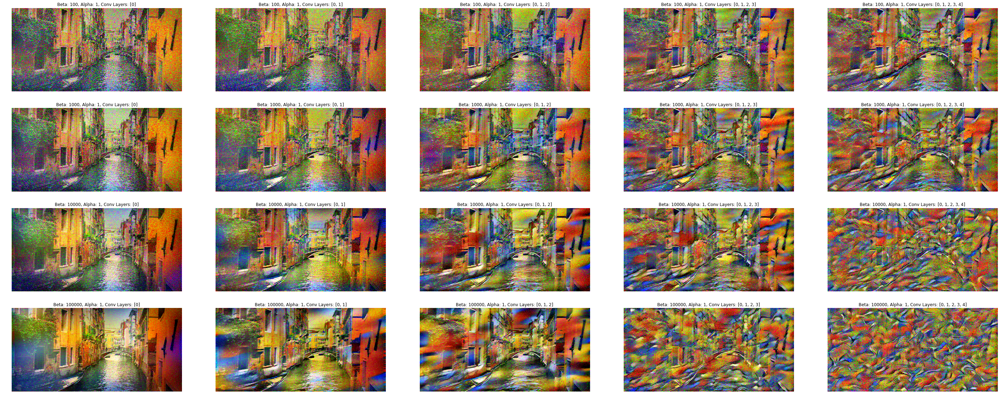

In [10]:
fig, axis = plt.subplots(4,5, figsize=(50,20))
ix = 0
betas = [100, 1000, 10000, 100000]
for r_ix, (axs, beta) in enumerate(zip(axis, betas)):
    ix = 0
    for c_ix, ax in enumerate(axs):
        files = glob('./exp5_style_vis/style_b{}/style_0-{}/ep_100*'.format(beta, ix))
        print(files)
        ax.axis("off")
        ax.set_title('Beta: {}, Alpha: {}, Conv Layers: {}'.format(beta, 1, str(list(range(ix+1)))))
        ax.imshow(plt.imread(files[-1]), aspect='auto')
        ix+=1

In [ ]:
fig, axis = plt.subplots(4,5, figsize=(50,20))
ix = 0
betas = [100, 10000, 1000000, 100000000]
for r_ix, (axs, beta) in enumerate(zip(axis, betas)):
    ix = 0
    for c_ix, ax in enumerate(axs):
        files = glob('./exp2_style_vis/style_b{}/style_{}/ep_19*'.format(beta, ix))
        print(files)
        ax.axis("off")
        ax.set_title('Beta: {}, Alpha: {}, Conv Layers: {}'.format(beta, 1, str(list(range(ix+1)))))
        ax.imshow(plt.imread(files[-1]), aspect='auto')
        ix+=1

In [ ]:
fig, axis = plt.subplots(2, 4, figsize=(20,10))
ix = 0
for r_ix, axs in enumerate(axis):
    for c_ix, ax in enumerate(axs):
        files = glob('./exp1/style_b1000/style_{}/ep_19*'.format(ix))
        ax.imshow(plt.imread(files[-1]))
        ix+=1

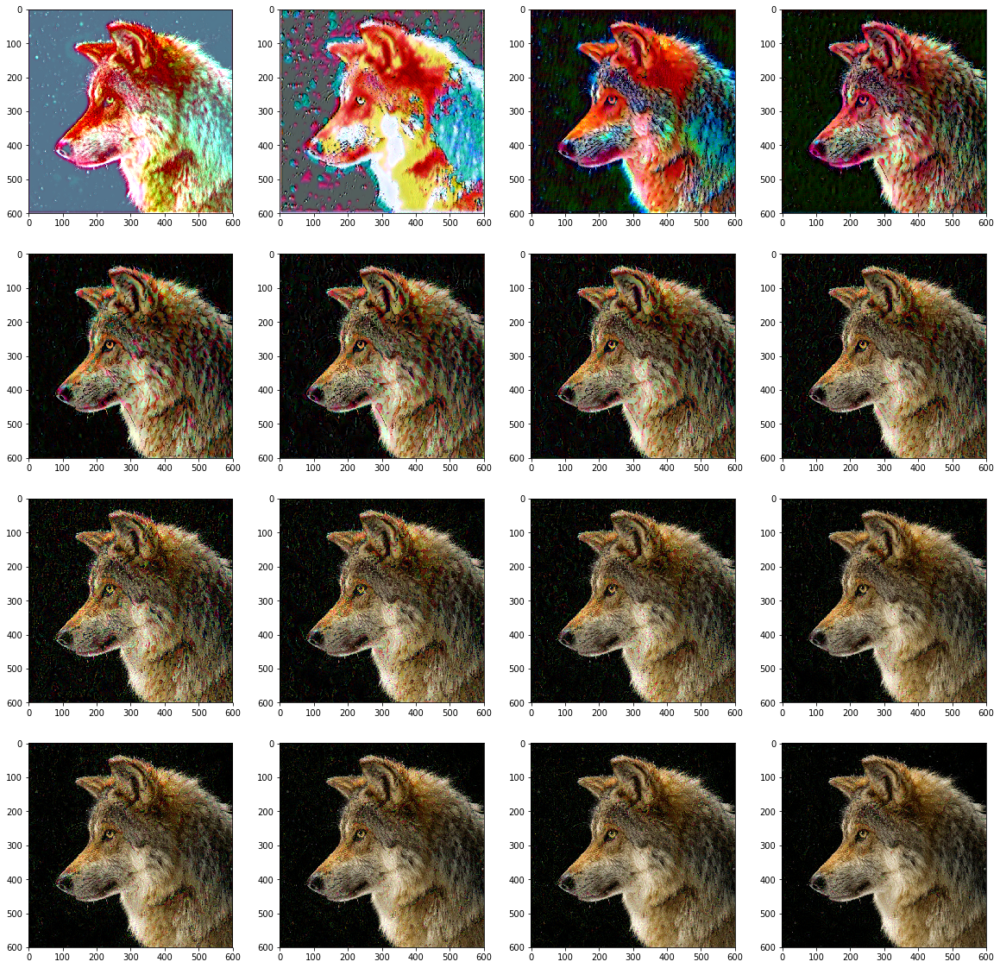

In [17]:
fig, axis = plt.subplots(4, 4, figsize=(20,20))
ix = 0
for r_ix, axs in enumerate(axis):
    for c_ix, ax in enumerate(axs):
        files = glob('./exp1/style_b100000/style_{}/ep_19*'.format(ix))
        ax.imshow(plt.imread(files[-1]))
        ix+=1

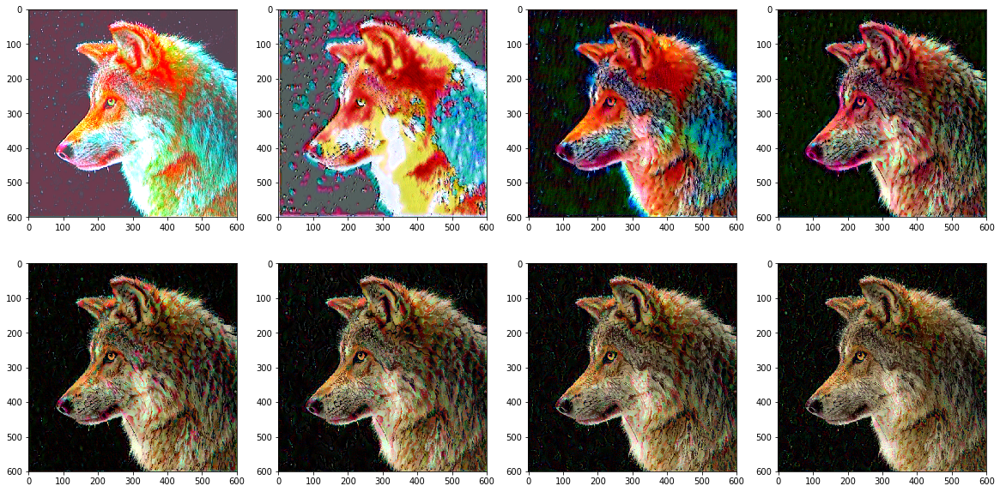

In [21]:
fig, axis = plt.subplots(2, 4, figsize=(20,10))
ix = 0
for r_ix, axs in enumerate(axis):
    for c_ix, ax in enumerate(axs):
        files = glob('./exp1/style_b1000000/style_{}/ep_19*'.format(ix))
        ax.imshow(plt.imread(files[-1]))
        ix+=1

In [29]:
transferer = StyleTransfer(vgg11.cuda(), c.cuda(), s.cuda(), [1], [-1], alpha=1, beta=1).cuda()
total_loss = StyleTransferLoss(transferer.style_losses, transferer.alpha, transferer.content_losses, transferer.beta)

var_img = torch.randn(c.shape).cuda().requires_grad_()
optimizer = torch.optim.LBFGS([var_img], lr=lr)

Found content!  1


In [31]:
for epoch in range(n_epochs):
    def closure():        
        optimizer.zero_grad()

         # Run current image through the model.
        transferer(var_img)

        loss = total_loss()
        
        loss.backward()
        return loss

    optimizer.step(closure)
    
    # Every 20 iters save a pic.
    print("Epoch: {}, Style Loss: {:6f}, Con Loss: {:6f}".format(epoch, total_loss.style_component, total_loss.content_component))
    cpu_img = var_img.cpu()[0, :, :, :]
    cpu_img = torch.clamp(cpu_img, 0, 1)
    cpu_img = torchvision.transforms.ToPILImage()(cpu_img)
    cpu_img.save('./garbage_folder/transfer-loss{}-{}.png'.format(epoch, total_loss.style_component + total_loss.content_component))

Epoch: 0, Style Loss: 0.000000, Con Loss: 0.051548
Epoch: 1, Style Loss: 0.000000, Con Loss: 0.013214
Epoch: 2, Style Loss: 0.000000, Con Loss: 0.005075


KeyboardInterrupt: 